In [4]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import geopandas as gpd
import rasterio
from rasterio.plot import reshape_as_image

import zipfile
import os

%matplotlib inline

In [3]:
!pip install rasterio

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.2/22.2 MB 49.3 MB/s eta 0:00:00:00:0100:01


As dataset I took from kaggle, but worked with smaller one that I created

In [5]:
df = gpd.read_file('/kaggle/input/deforestation-in-ukraine/deforestation_labels.geojson')
base_dataset_path = '/kaggle/input/deforestation-in-ukraine/'
development_dataset_path = '/kaggle/working/smaller_dev_dataset/'
df

,img_date,tile,geometry
0,2016-04-09,36UXA,"POLYGON ((35.79130 50.17406, 35.79277 50.17354..."
1,2016-04-09,36UXA,"POLYGON ((35.77653 50.10271, 35.77810 50.10318..."
2,2016-04-09,36UXA,"POLYGON ((35.78621 50.01277, 35.78616 50.01369..."
3,2016-04-09,36UXA,"POLYGON ((35.78007 50.00556, 35.78189 50.00557..."
4,2016-04-09,36UXA,"POLYGON ((35.79781 49.99568, 35.79908 49.99582..."
...,...,...,...
5691,2019-09-09,36UYA,"POLYGON ((36.37494 50.17378, 36.37506 50.17376..."
5692,2019-09-09,36UYA,"POLYGON ((36.37849 50.17354, 36.37851 50.17352..."
5693,2019-09-09,36UYA,"POLYGON ((35.91477 50.22407, 35.91472 50.22394..."
5694,2019-10-26,36UYA,"POLYGON ((36.88312 50.26589, 36.88408 50.26489..."


In [6]:
import os
import glob
import cv2

def preprocess_and_save_images(base_dataset_path, dev_dataset_path, max_dimension=1024):
    """
    Here we aim to get all images from our original folder to easier work with photos in the future
    """
    if not os.path.exists(dev_dataset_path):
        os.makedirs(dev_dataset_path)

    for folder in os.listdir(base_dataset_path):
        img_data_path = os.path.join(base_dataset_path, folder, "*.SAFE/GRANULE/*/IMG_DATA/*_TCI.jp2")
        tci_image_files = glob.glob(img_data_path)

        for image_file in tci_image_files:
            preprocessed_image = load_and_preprocess_image(image_file, max_dimension)
            dest_image_path = os.path.join(dev_dataset_path, os.path.basename(image_file).replace('.jp2', '.jpg'))
            
            # save the preprocessed image as a JPEG with quality set to 90, as with higher one it would take too much memory
            cv2.imwrite(dest_image_path, preprocessed_image, [int(cv2.IMWRITE_JPEG_QUALITY), 90])

            print(f"Image saved at: {dest_image_path}")

def load_and_preprocess_image(image_path, max_dimension=1024):
    """
    here we perform resizing of an image
    """
    img = cv2.imread(image_path, 0)
    height, width = img.shape
    # here we calculate scaling factor to resize the image to the max_dimension
    scale = max_dimension / max(height, width)
    # here we perform resizing according to the scale
    resized_img = cv2.resize(img, (int(width * scale), int(height * scale)))
    return resized_img
preprocess_and_save_images(base_dataset_path, development_dataset_path)


Image saved at: /kaggle/working/smaller_dev_dataset/T36UYA_20160212T084052_TCI.jpg
Image saved at: /kaggle/working/smaller_dev_dataset/T36UYA_20160621T084012_TCI.jpg
Image saved at: /kaggle/working/smaller_dev_dataset/T36UXA_20190606T083601_TCI.jpg
Image saved at: /kaggle/working/smaller_dev_dataset/T36UYA_20190313T083739_TCI.jpg
Image saved at: /kaggle/working/smaller_dev_dataset/T36UYA_20190611T083609_TCI.jpg
Image saved at: /kaggle/working/smaller_dev_dataset/T36UXA_20190427T083601_TCI.jpg
Image saved at: /kaggle/working/smaller_dev_dataset/T36UYA_20190701T083609_TCI.jpg
Image saved at: /kaggle/working/smaller_dev_dataset/T36UXA_20180726T084009_TCI.jpg
Image saved at: /kaggle/working/smaller_dev_dataset/T36UYA_20190721T083609_TCI.jpg
Image saved at: /kaggle/working/smaller_dev_dataset/T36UYA_20190621T083609_TCI.jpg
Image saved at: /kaggle/working/smaller_dev_dataset/T36UYA_20190825T083601_TCI.jpg
Image saved at: /kaggle/working/smaller_dev_dataset/T36UYA_20190318T083701_TCI.jpg
Imag

Lets see how our image look like

In [7]:
RASTER_PATH = '/kaggle/input/deforestation-in-ukraine/S2B_MSIL1C_20190611T083609_N0207_R064_T36UYA_20190611T122426/S2B_MSIL1C_20190611T083609_N0207_R064_T36UYA_20190611T122426.SAFE/GRANULE/L1C_T36UYA_A011816_20190611T084501/IMG_DATA/T36UYA_20190611T083609_TCI.jp2'

with rasterio.open(RASTER_PATH, "r", driver='JP2OpenJPEG') as src:
    raster_image = src.read()
    raster_meta = src.meta

In [6]:
raster_image.shape

(3, 10980, 10980)

In [7]:
raster_meta

{'driver': 'JP2OpenJPEG',
 'dtype': 'uint8',
 'nodata': None,
 'width': 10980,
 'height': 10980,
 'count': 3,
 'crs': CRS.from_epsg(32636),
 'transform': Affine(10.0, 0.0, 699960.0,
        0.0, -10.0, 5600040.0)}

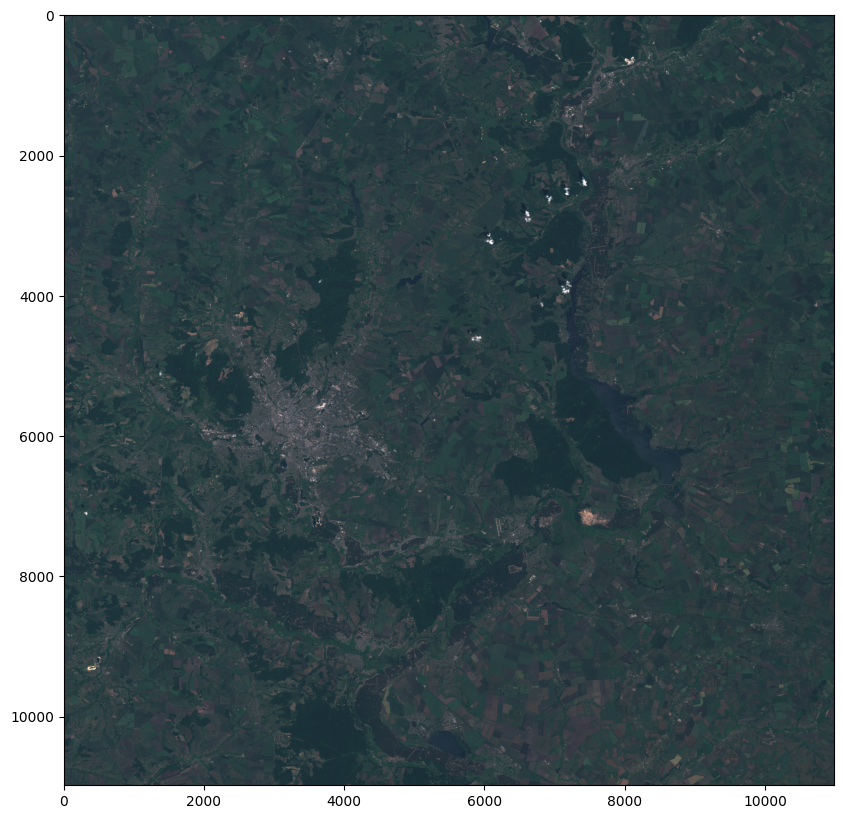

In [8]:
raster_img = reshape_as_image(raster_image)
plt.figure(figsize=(10, 10))
plt.imshow(raster_img)

Here I wrote visualization functions

In [8]:
def visualize_keypoints(image, keypoints, title='Keypoints'):
    """
    function just to visualize our keypoints on image
    """
    keypoint_image = cv2.drawKeypoints(image, keypoints, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
    plt.figure(figsize=(10, 10))
    plt.imshow(keypoint_image, cmap='gray')
    plt.title(title)
    plt.axis('off')
    plt.show()

def visualize_matches(img1, kp1, img2, kp2, matches, title='Matches'):
    """
    function just to visualize our matches on images
    """
    match_img = cv2.drawMatches(img1, kp1, img2, kp2, matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.figure(figsize=(15, 10))
    plt.imshow(match_img, cmap='gray')
    plt.title(title)
    plt.axis('off')
    plt.show()

def visualize_inliers(img1, kp1, img2, kp2, matches, mask, title='Inliers'):
    """
    function just to visualize our inliers on images
    """
    inlier_matches = [m for m, inlier in zip(matches, mask.ravel()) if inlier]
    inlier_img = cv2.drawMatches(img1, kp1, img2, kp2, inlier_matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.figure(figsize=(15, 10))
    plt.imshow(inlier_img, cmap='gray')
    plt.title(title)
    plt.axis('off')
    plt.show

In [9]:
def trim_black_borders(image):
    """
    This function removes any black or empty areas surrounding the non-black regions of the image
    """
    if len(image.shape) == 3:
        gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    else:
        gray = image.copy()
    _, thresh = cv2.threshold(gray, 1, 255, cv2.THRESH_BINARY)
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if not contours:
        return image
    largest_contour = max(contours, key=cv2.contourArea)
    x, y, w, h = cv2.boundingRect(largest_contour)
    trimmed_image = image[y:y+h, x:x+w]
    return trimmed_image

In [10]:
def stitch_images(img1, img2, visualize=False):
    """
    Stitch two images together to create a panorama, also I perform here normalization

    This function uses 
        - SIFT for reature detection and description
        - KNN for feature matching 
        - RANSAC for homography estimation
    """
    gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY) if len(img1.shape) == 3 else img1
    gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY) if len(img2.shape) == 3 else img2
    
    normalized_gray1 = cv2.normalize(gray1, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)
    normalized_gray2 = cv2.normalize(gray2, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)
    
    sift = cv2.SIFT_create()
    kp1, des1 = sift.detectAndCompute(normalized_gray1, None)
    kp2, des2 = sift.detectAndCompute(normalized_gray2, None)

    if visualize:
        visualize_keypoints(gray1, kp1, title='Keypoints in Image 1')
        visualize_keypoints(gray2, kp2, title='Keypoints in Image 2')

    FLANN_INDEX_KDTREE = 1
    index_params = dict(algorithm=FLANN_INDEX_KDTREE, trees=5)
    search_params = dict(checks=50)
    flann = cv2.FlannBasedMatcher(index_params, search_params)

    matches = flann.knnMatch(des1, des2, k=2)

    good_matches = []
    for m, n in matches:
        if m.distance < 0.7 * n.distance:
            good_matches.append(m)

    if visualize:
        visualize_matches(gray1, kp1, gray2, kp2, good_matches, title='Good Matches')

    if len(good_matches) < 4:
        print(f"Not enough matches are found - {len(good_matches)}/4")
        return None

    src_pts = np.float32([kp1[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
    dst_pts = np.float32([kp2[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)

    H, mask = cv2.findHomography(dst_pts, src_pts, cv2.RANSAC, 5.0)

    if visualize:
        visualize_inliers(gray1, kp1, gray2, kp2, good_matches, mask, title='Inlier Matches')

    height1, width1 = img1.shape[:2]
    height2, width2 = img2.shape[:2]

    corners_img2 = np.float32([[0,0], [0, height2], [width2, height2], [width2,0]]).reshape(-1,1,2)
    transformed_corners_img2 = cv2.perspectiveTransform(corners_img2, H)

    all_corners = np.concatenate((np.float32([[0,0], [0, height1], [width1, height1], [width1,0]]).reshape(-1,1,2), transformed_corners_img2), axis=0)
    [xmin, ymin] = np.int32(all_corners.min(axis=0).ravel() - 0.5)
    [xmax, ymax] = np.int32(all_corners.max(axis=0).ravel() + 0.5)

    translation_dist = [-xmin, -ymin]
    H_translation = np.array([[1, 0, translation_dist[0]],
                              [0, 1, translation_dist[1]],
                              [0, 0, 1]])

    panorama = cv2.warpPerspective(img2, H_translation.dot(H), (xmax - xmin, ymax - ymin))
    panorama[translation_dist[1]:height1+translation_dist[1], translation_dist[0]:width1+translation_dist[0]] = img1

    panorama = trim_black_borders(panorama)

    return panorama

In [11]:
def create_panorama(image_paths, visualize=False):
    """
    Here I finally perform stitching
    """
    if len(image_paths) < 2:
        print("Need at least two images to create a panorama.")
        return None

    panorama = cv2.imread(image_paths[0])
    if panorama is None:
        print(f"Unable to read image: {image_paths[0]}")
        return None

    for i in range(1, len(image_paths)):
        next_image = cv2.imread(image_paths[i])
        if next_image is None:
            print(f"Unable to read image: {image_paths[i]}")
            continue

        print(f"Stitching image {i} of {len(image_paths)-1}: {image_paths[i]}")
        panorama = stitch_images(panorama, next_image, visualize=visualize)
        if panorama is None:
            print("Stitching failed.")
            return None

    return panorama

Here we try to stitch two images together

Stitching image 1 of 1: /kaggle/input/test-dataset/bridge2.jpg


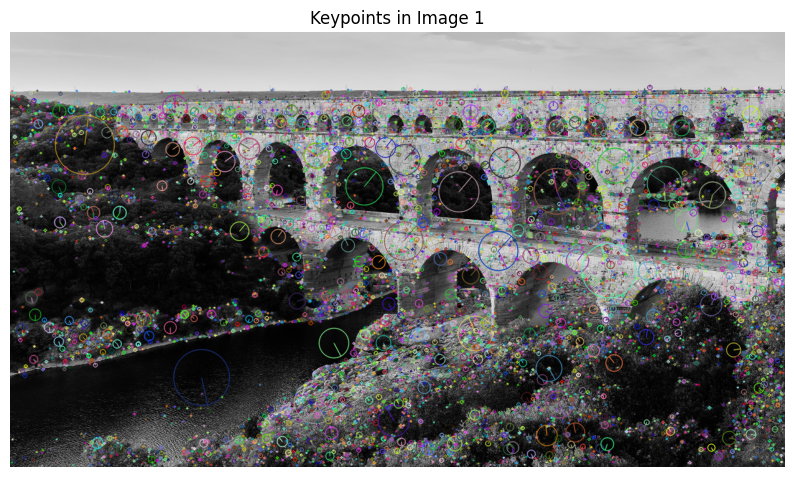

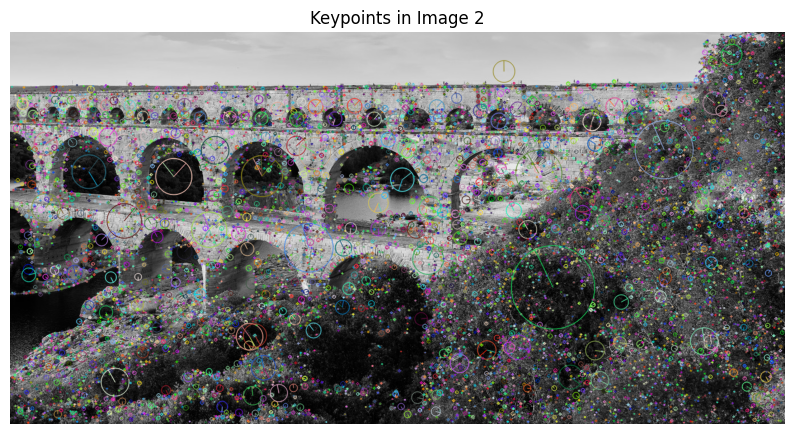

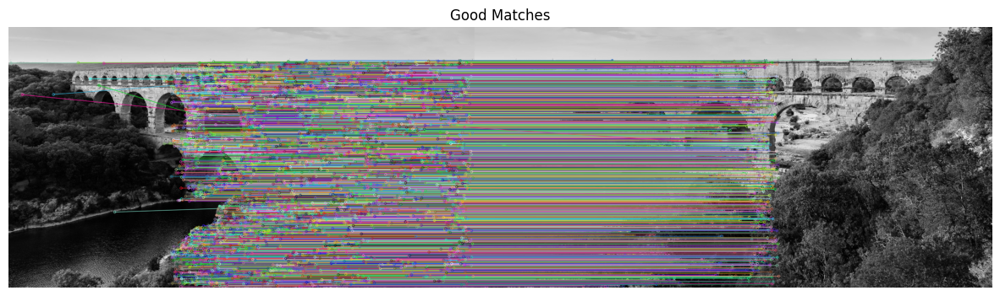

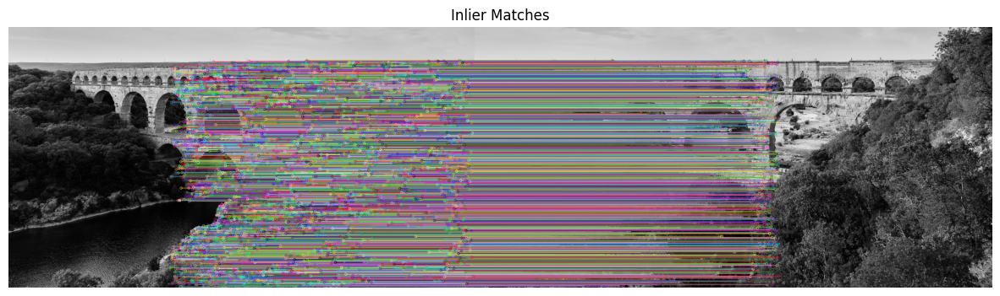

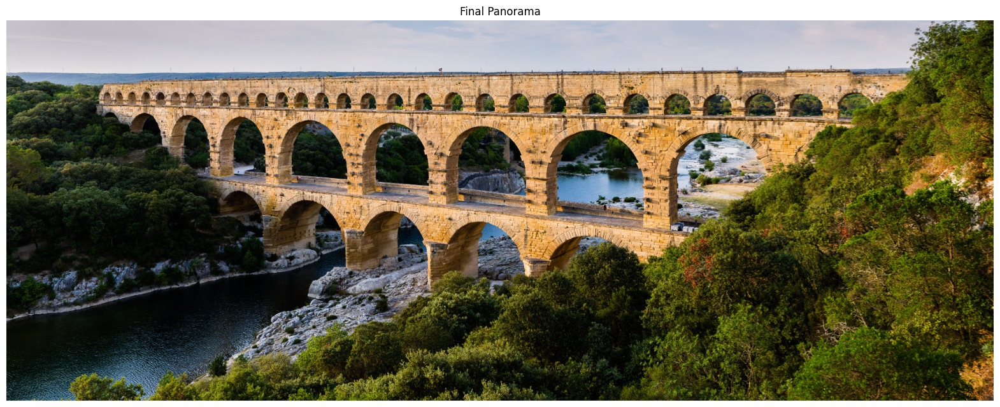

In [15]:
preprocessed_images = ['/kaggle/input/test-dataset/bridge1.jpg',
                       '/kaggle/input/test-dataset/bridge2.jpg']


panorama = create_panorama(preprocessed_images, visualize=True)

if panorama is not None:
    plt.figure(figsize=(20, 10))
    if len(panorama.shape) == 2:
        plt.imshow(panorama, cmap='gray')
    else:
        plt.imshow(cv2.cvtColor(panorama, cv2.COLOR_BGR2RGB))
    plt.title('Final Panorama')
    plt.axis('off')
    plt.show()

Perfect panorama!

Stitching image 1 of 2: /kaggle/input/test-dataset/sun2.jpg


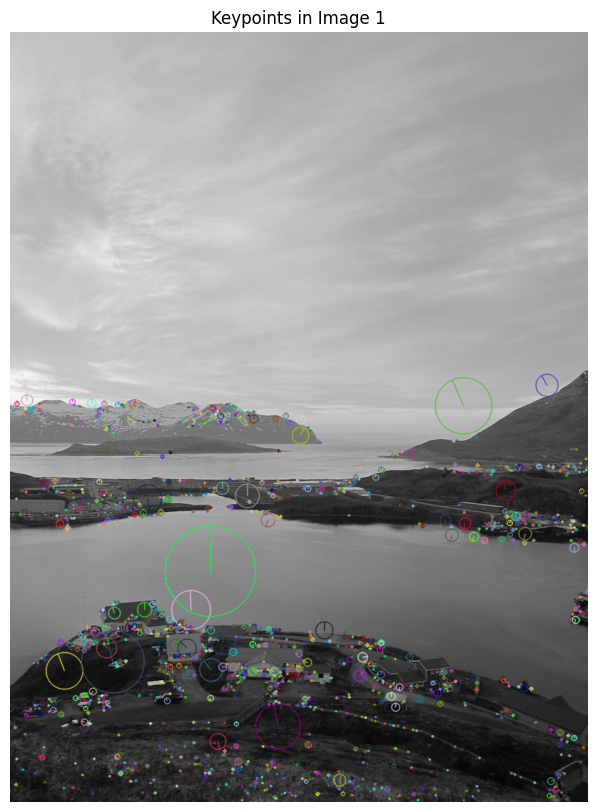

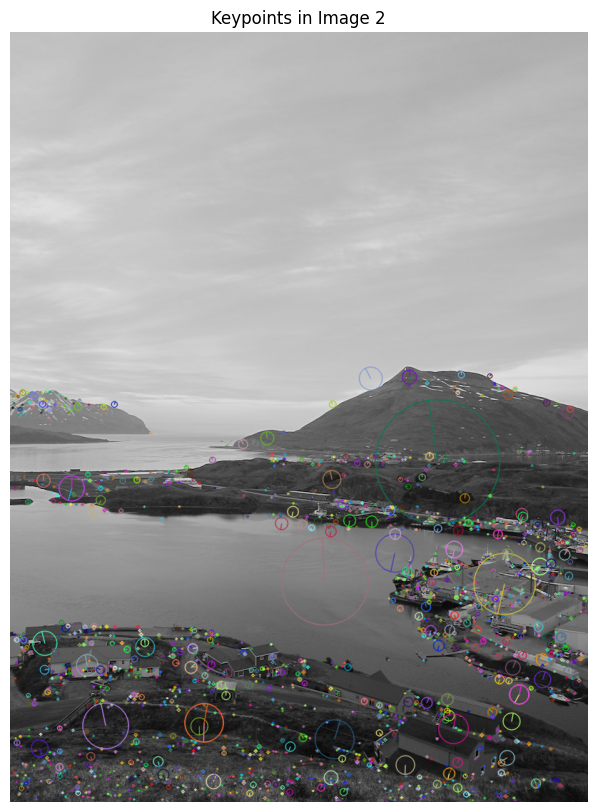

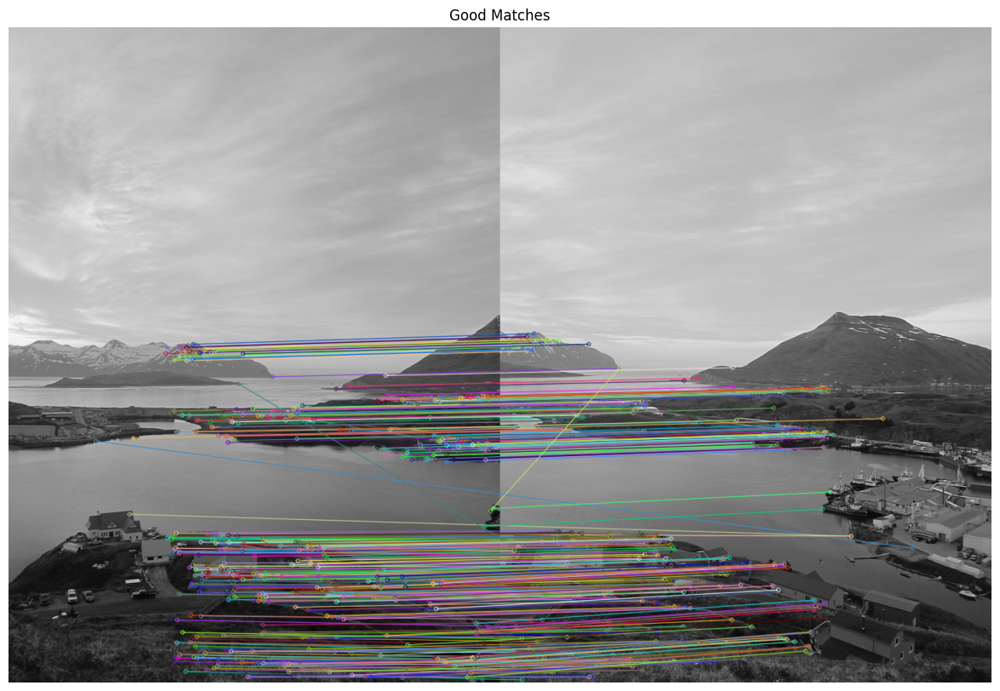

Stitching image 2 of 2: /kaggle/input/test-dataset/sun3.jpg


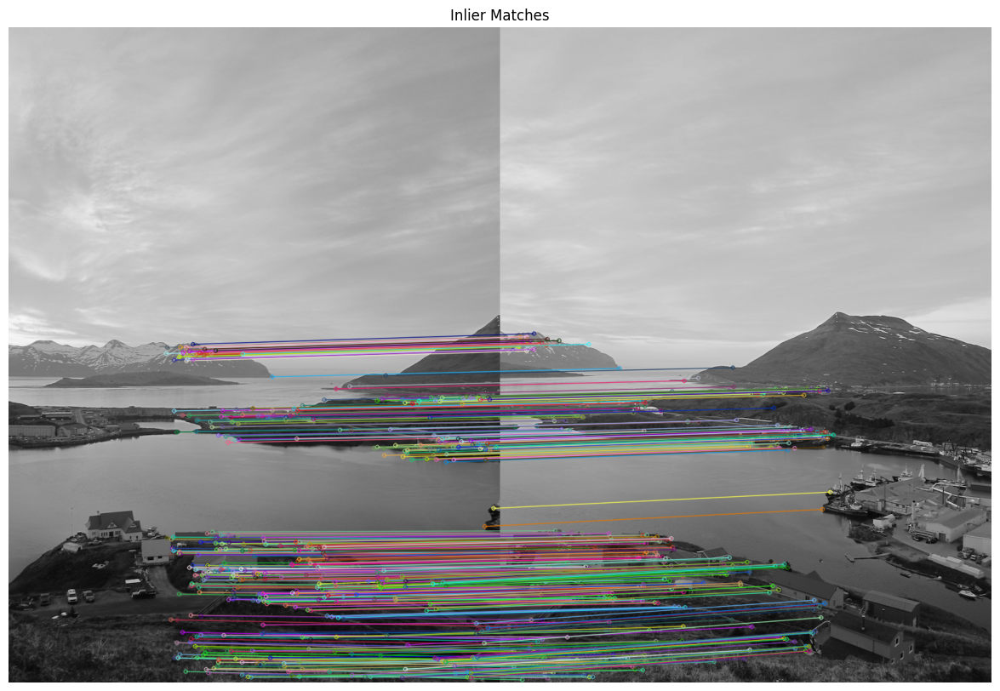

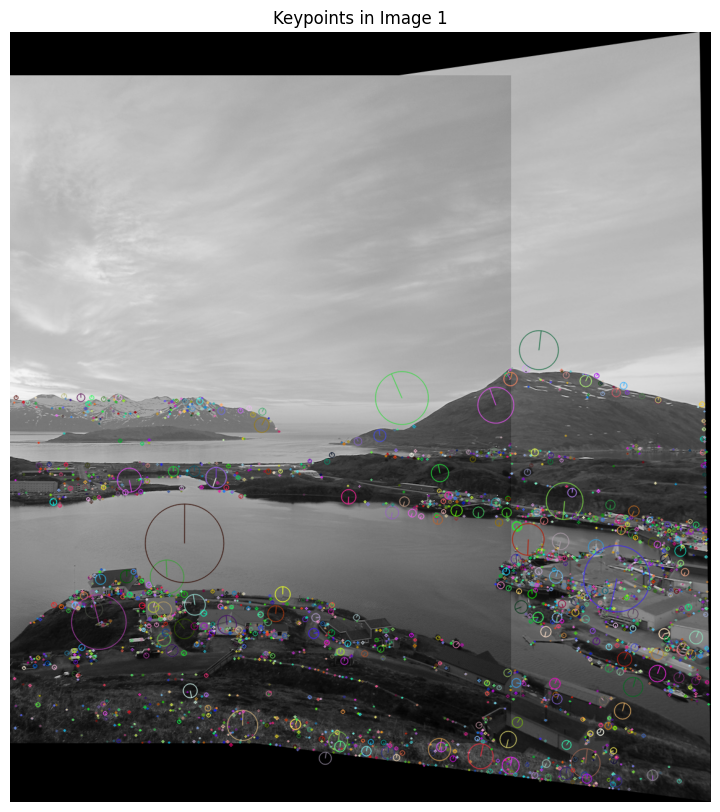

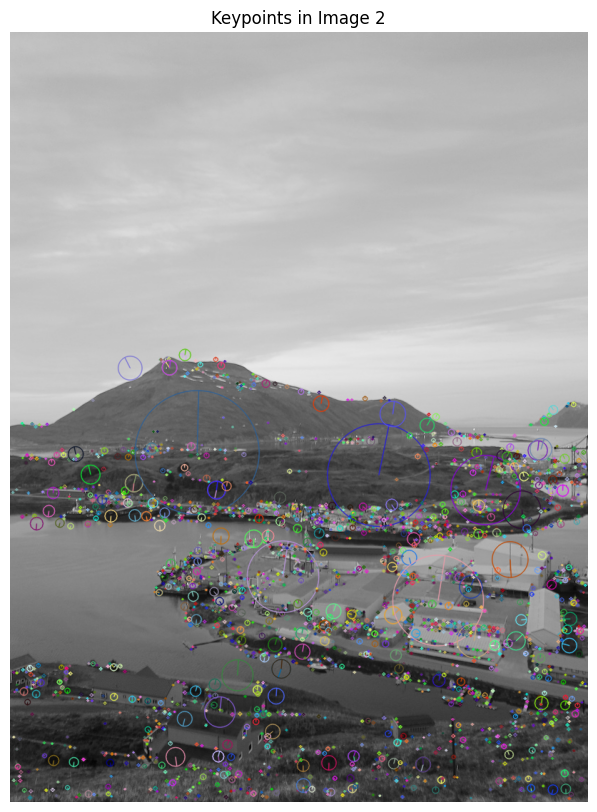

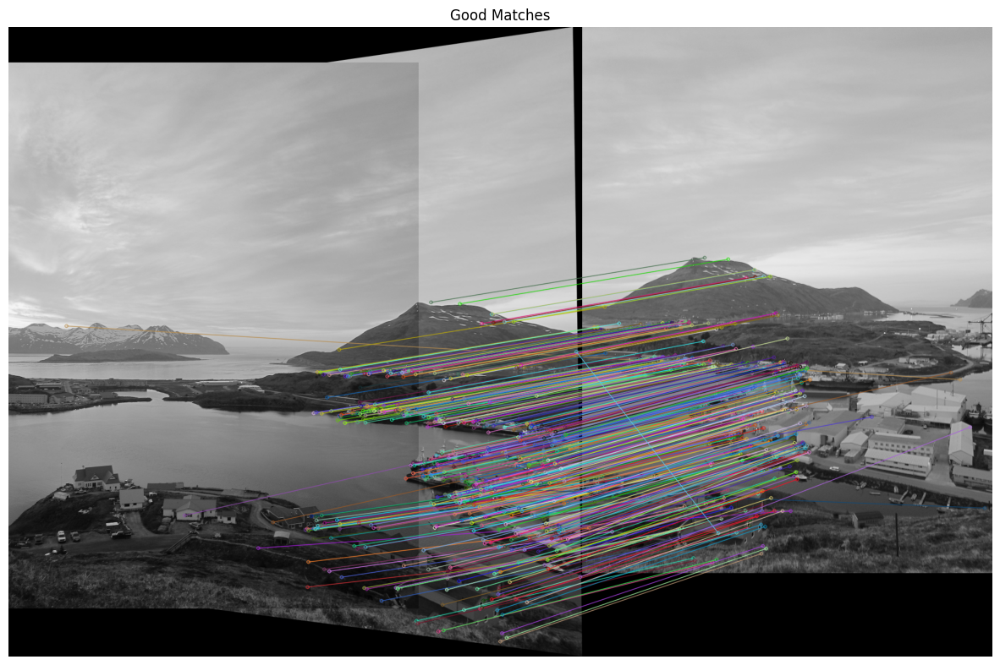

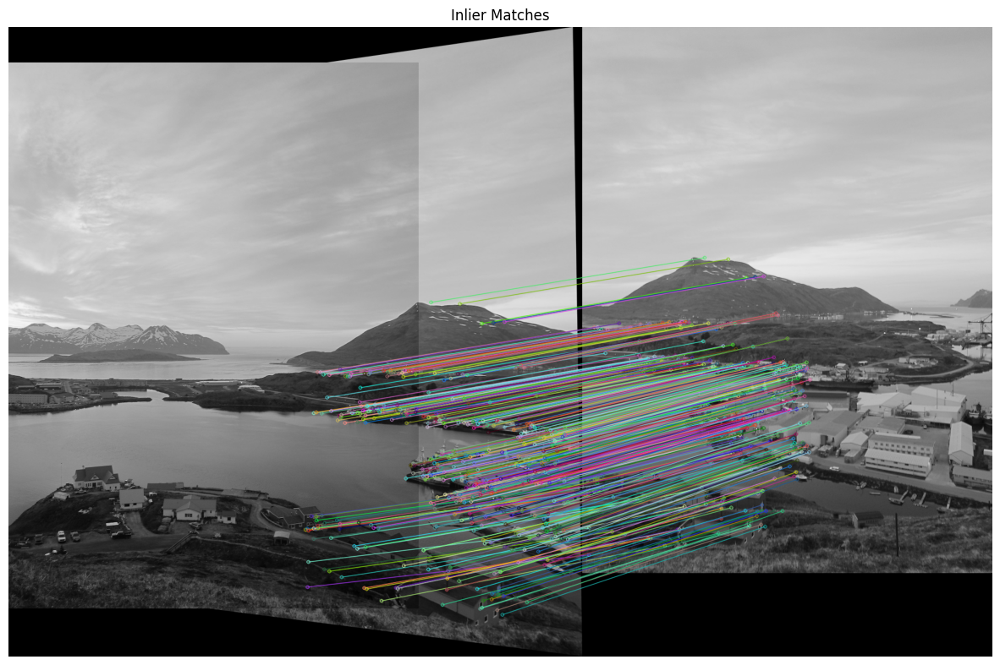

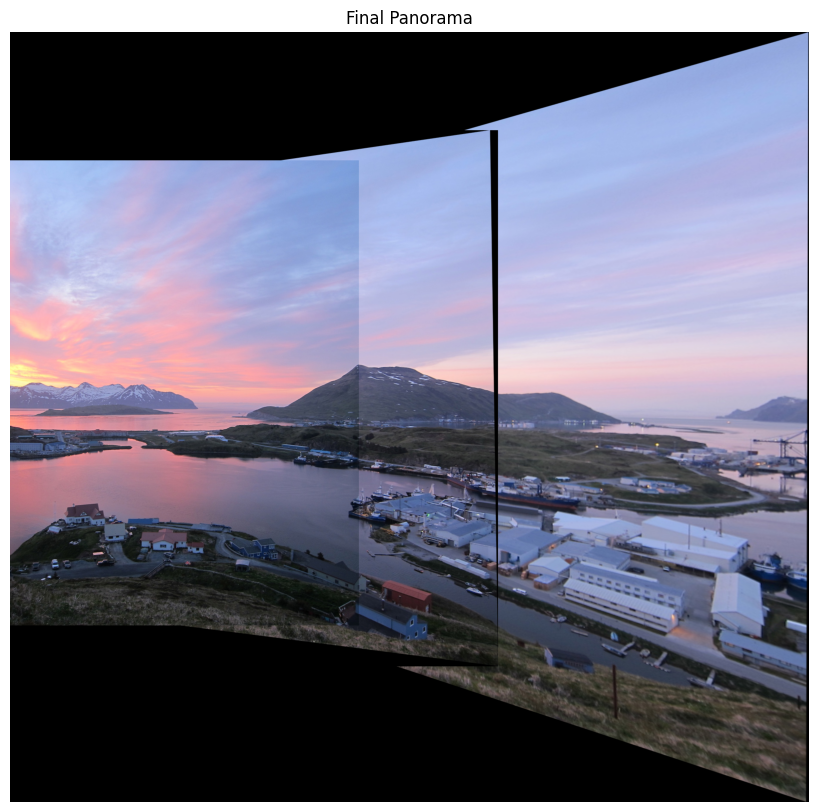

In [14]:
preprocessed_images = ['/kaggle/input/test-dataset/sun1.jpg',
                       '/kaggle/input/test-dataset/sun2.jpg',
                       '/kaggle/input/test-dataset/sun3.jpg']


panorama = create_panorama(preprocessed_images, visualize=True)

if panorama is not None:
    plt.figure(figsize=(20, 10))
    if len(panorama.shape) == 2:
        plt.imshow(panorama, cmap='gray')
    else:
        plt.imshow(cv2.cvtColor(panorama, cv2.COLOR_BGR2RGB))
    plt.title('Final Panorama')
    plt.axis('off')
    plt.show()

Here we have such situation that our images are taken from differents engles and as a result we receive panorama with black fields

Stitching image 1 of 1: /kaggle/working/smaller_dev_dataset/T36UYA_20161205T083332_TCI.jpg


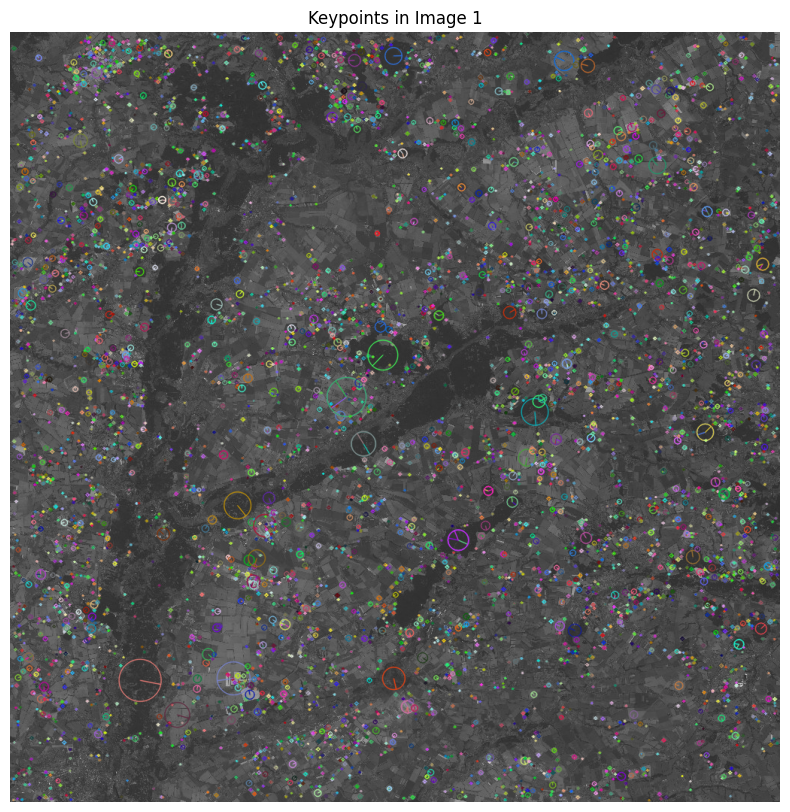

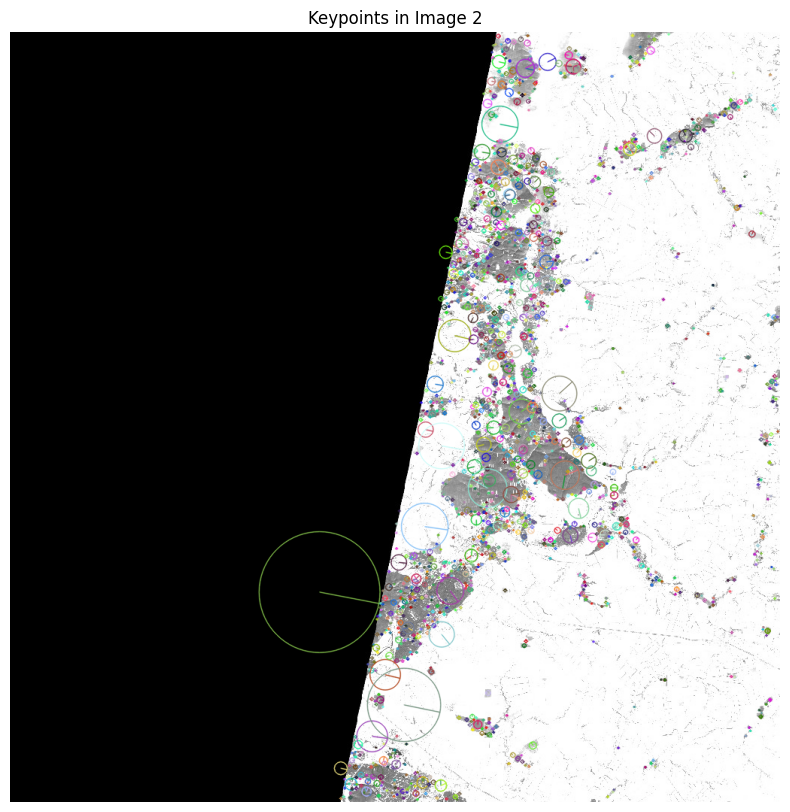

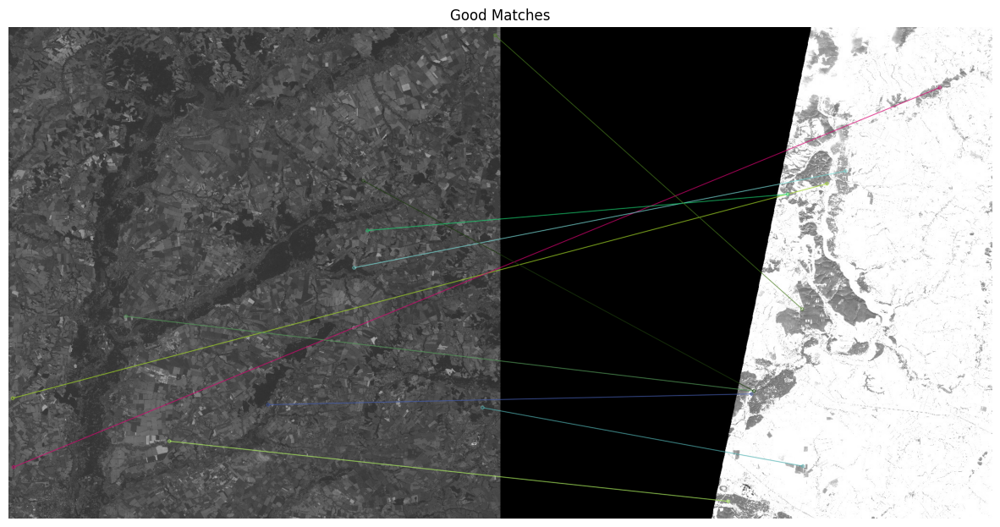

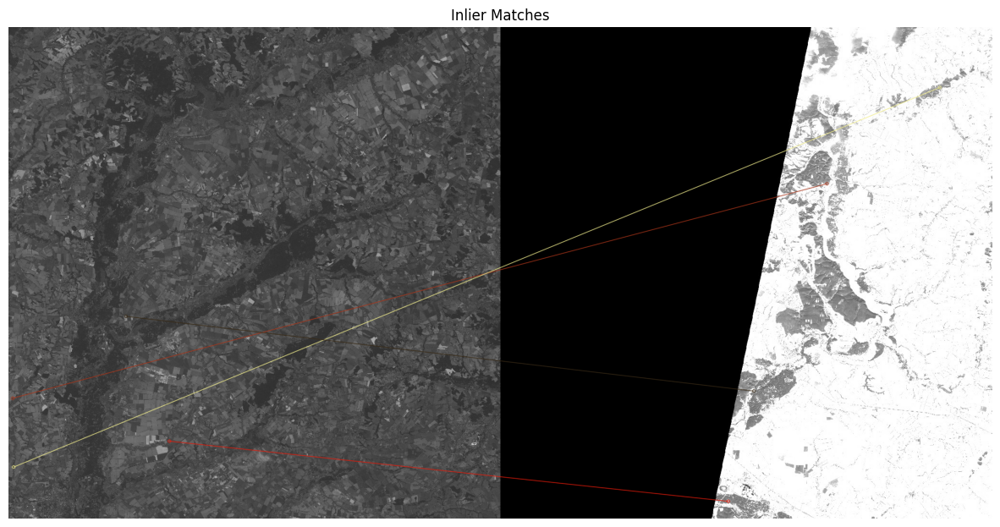

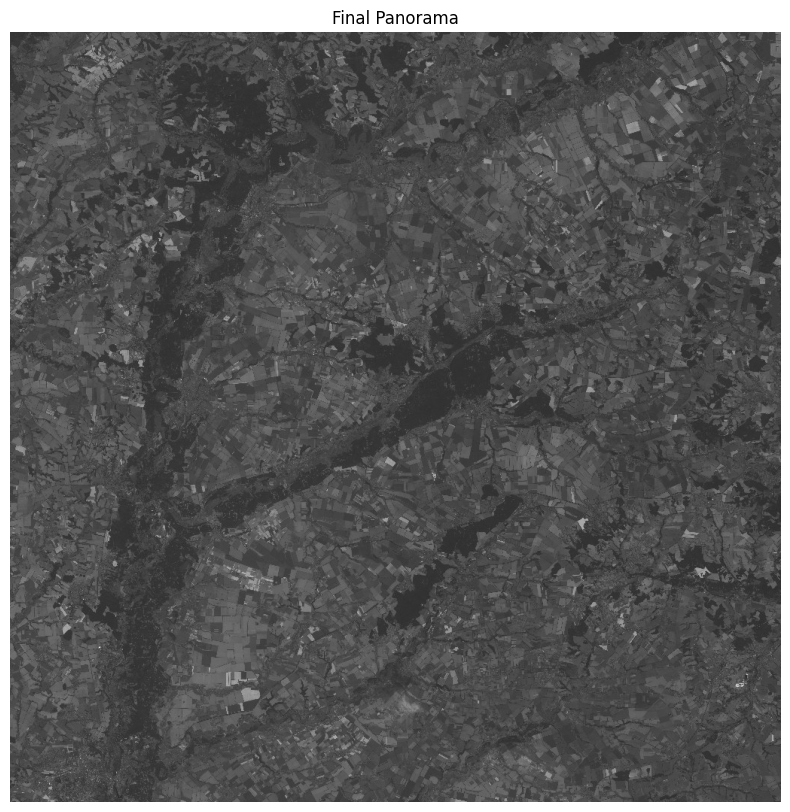

In [17]:
preprocessed_images = ['/kaggle/working/smaller_dev_dataset/T36UXA_20180904T083549_TCI.jpg',
                        '/kaggle/working/smaller_dev_dataset/T36UYA_20161205T083332_TCI.jpg']


panorama = create_panorama(preprocessed_images, visualize=True)

if panorama is not None:
    plt.figure(figsize=(20, 10))
    if len(panorama.shape) == 2:
        plt.imshow(panorama, cmap='gray')
    else:
        plt.imshow(cv2.cvtColor(panorama, cv2.COLOR_BGR2RGB))
    plt.title('Final Panorama')
    plt.axis('off')
    plt.show()

Unfortunately our algirithm dont detect when our images have different masks and as a result dont perform stitching as it didnt find the keypoints

In [18]:
def zip_directory(folder_path, output_zip_path):
    """Zip the contents of an entire folder"""
    with zipfile.ZipFile(output_zip_path, 'w', zipfile.ZIP_DEFLATED) as zipf:
        for root, _, files in os.walk(folder_path):
            for file in files:
                file_path = os.path.join(root, file)
                zipf.write(file_path, os.path.relpath(file_path, folder_path))

folder_to_zip = '/kaggle/working/my_folder'
output_zip_file = '/kaggle/working/my_archive.zip'

zip_directory('smaller_dev_dataset', output_zip_file)

print(f"Zipped folder '{folder_to_zip}' into '{output_zip_file}'")


Zipped folder '/kaggle/working/my_folder' into '/kaggle/working/my_archive.zip'


Stitching image 1 of 1: /kaggle/working/smaller_dev_dataset/T36UXA_20180820T083601_TCI.jpg


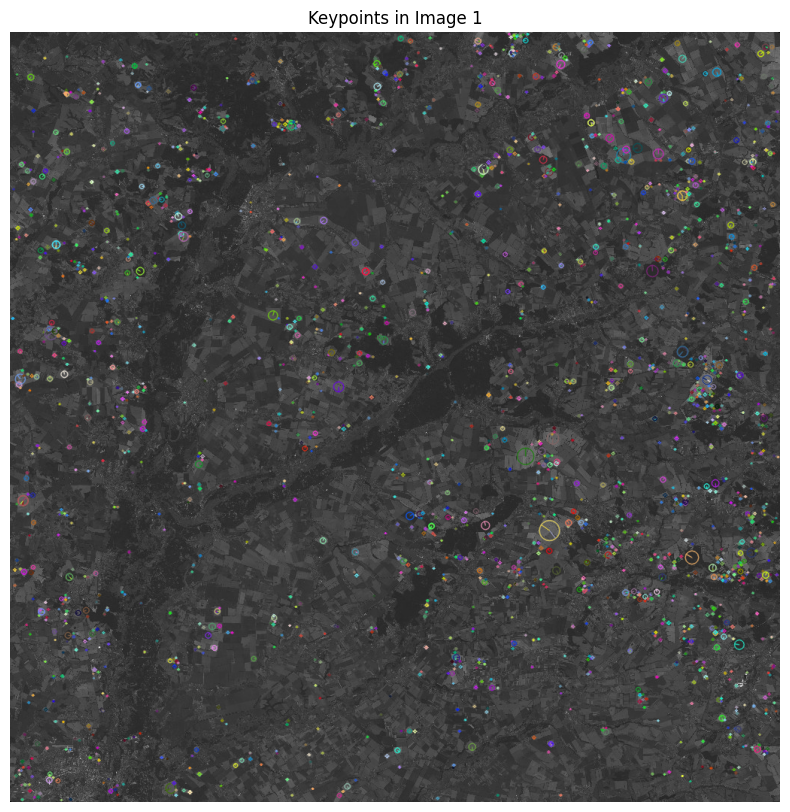

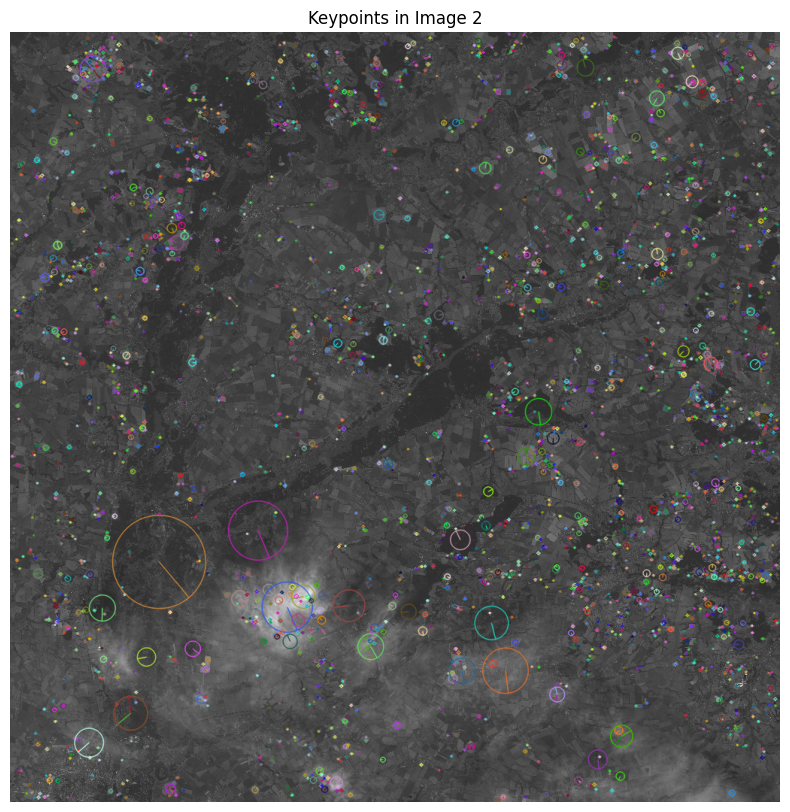

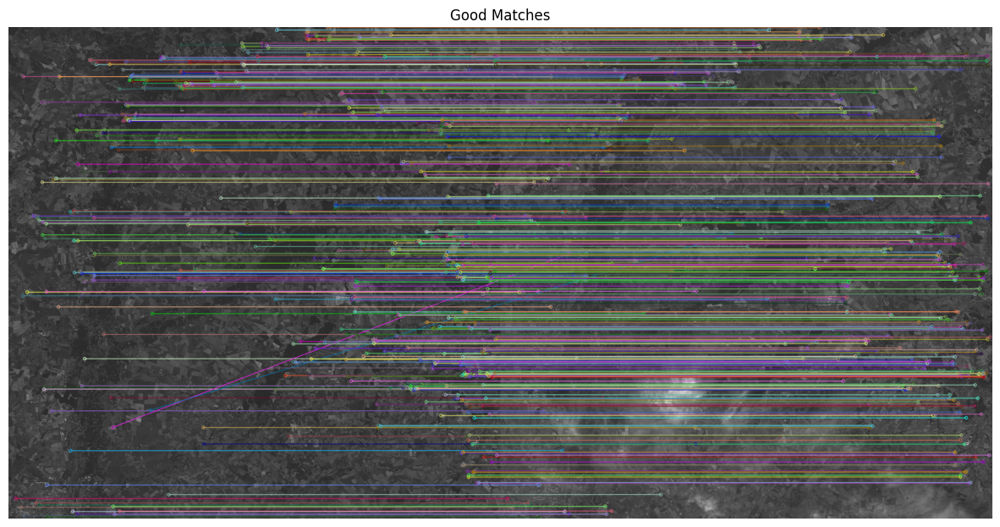

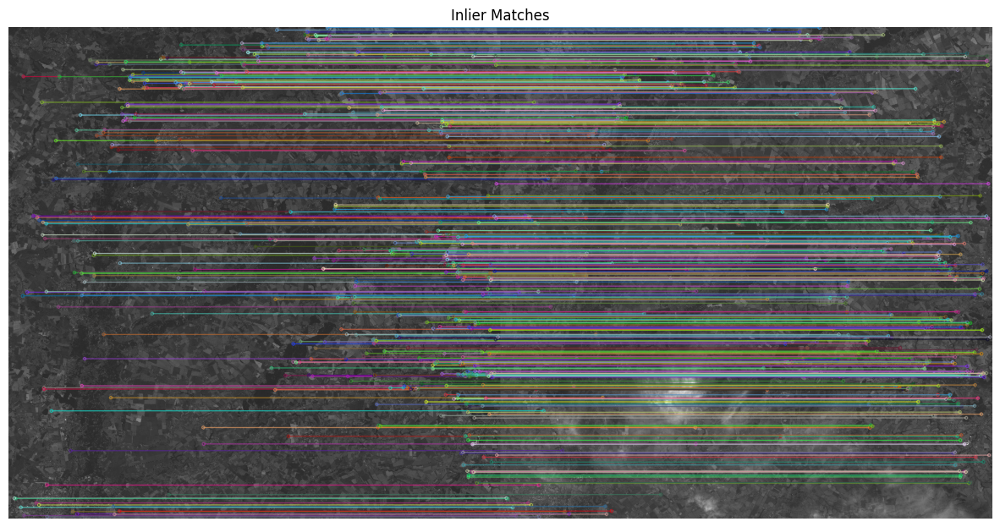

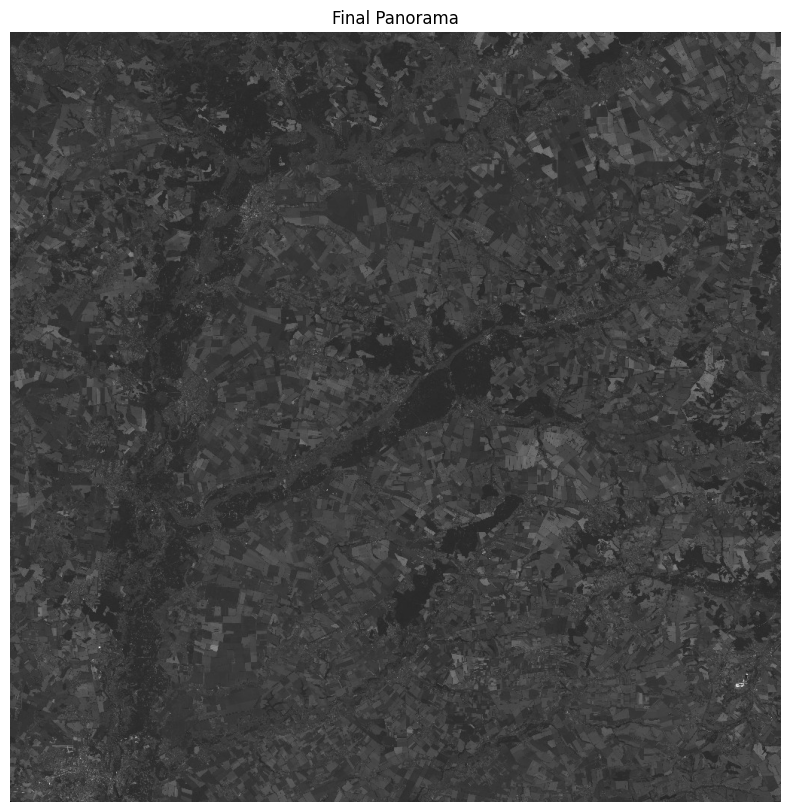

In [19]:
preprocessed_images = ['/kaggle/working/smaller_dev_dataset/T36UXA_20180810T083601_TCI.jpg',
                        '/kaggle/working/smaller_dev_dataset/T36UXA_20180820T083601_TCI.jpg']


panorama = create_panorama(preprocessed_images, visualize=True)

if panorama is not None:
    plt.figure(figsize=(20, 10))
    if len(panorama.shape) == 2:
        plt.imshow(panorama, cmap='gray')
    else:
        plt.imshow(cv2.cvtColor(panorama, cv2.COLOR_BGR2RGB))
    plt.title('Final Panorama')
    plt.axis('off')
    plt.show()


Perfect panorama!